In [1]:
from logging_ import Logger
import matplotlib.pyplot as plt
from matplotlib.markers import MarkerStyle
import pandas as pd
from settings import OPTIMAL_HYPERS_BEST, OPTIMAL_HYPERS_NORM
from scores import  SCORES

%load_ext autoreload
%autoreload 2

In [2]:
logger = Logger(logs_dir="logs")

In [3]:
logger.load_all()

In [4]:
# DECIDE WHETHER TO add "all" versions wrt individual samples or not

best_wrt_sample = True

for norm in OPTIMAL_HYPERS_NORM:
        for model in SCORES[norm][0]:
            logger.merge(f"dataset-CIFAR10-norm-{norm}-attack-auto_all-model-{model}", [*logger.where(norm=norm, attack="aa", model=model).keys()])

if best_wrt_sample:
    OPTIMAL_HYPERS = OPTIMAL_HYPERS_BEST
    for norm in OPTIMAL_HYPERS:
        for model in SCORES[norm][0]:
            for attack in ["fmn", "alma", "ddn", "apgd", "pdpgd", "pdgd"]:
                run_ids = [*list(logger.where(model=model, attack=attack, **OPTIMAL_HYPERS[norm]).keys())]
                is_slow = lambda x: logger.get_n_steps(x) > 999
                quick_ids = [*filter(lambda x: not is_slow(x), run_ids)]
                slow_ids = [*filter(is_slow, run_ids)]
                if slow_ids:
                    logger.merge(f"dataset-CIFAR10-norm-{norm}-attack-{attack}_all-model-{model}-steps-1001", slow_ids)
                if quick_ids:
                    logger.merge(f"dataset-CIFAR10-norm-{norm}-attack-{attack}_all-model-{model}-steps-101", quick_ids)

OPTIMAL_HYPERS = OPTIMAL_HYPERS_NORM

# Pair comparison 
Investigate the influence of attacking other class 

In [5]:
sumdic_slow, sumdic_quick = logger.extract_sumdic(OPTIMAL_HYPERS, SCORES)

In [6]:
sumdic=sumdic_slow

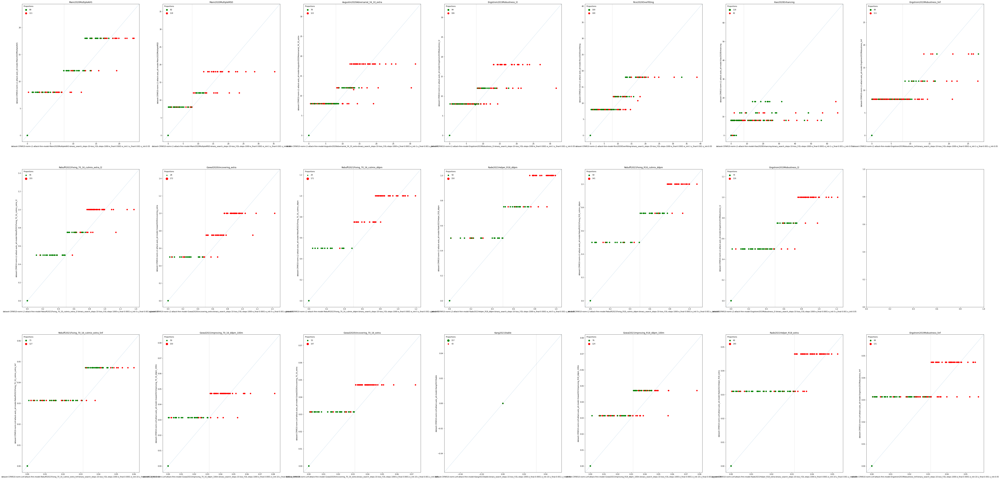

In [7]:
critical = logger.plot_compare_grid(sumdic, a="fmn", b="auto_all", figsize=(100,50), simple=True)

<__array_function__ internals>:180: UserWarning: Warning: converting a masked element to nan.
/opt/conda/lib/python3.8/site-packages/matplotlib/colors.py:1211: UserWarning: Warning: converting a masked element to nan.
  data = np.asarray(value)
/opt/conda/lib/python3.8/site-packages/matplotlib/ticker.py:547: UserWarning: Warning: converting a masked element to nan.
  if self._useLocale else fmt % arg)


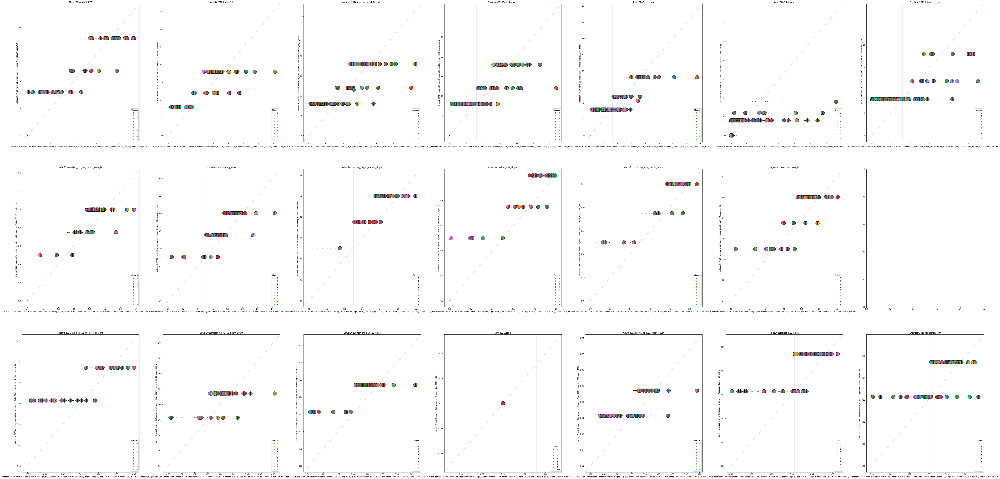

In [8]:
logger.plot_compare_grid(sumdic, a="fmn", b="auto_all", figsize=(100,50))
None

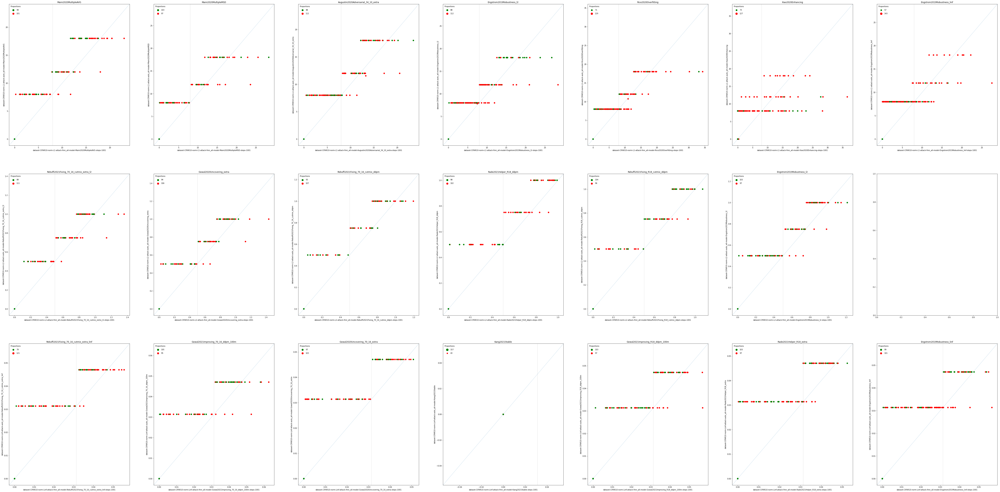

In [9]:
logger.plot_compare_grid(sumdic, a="fmn_all", b="auto_all", figsize=(100,50), simple=True)
None

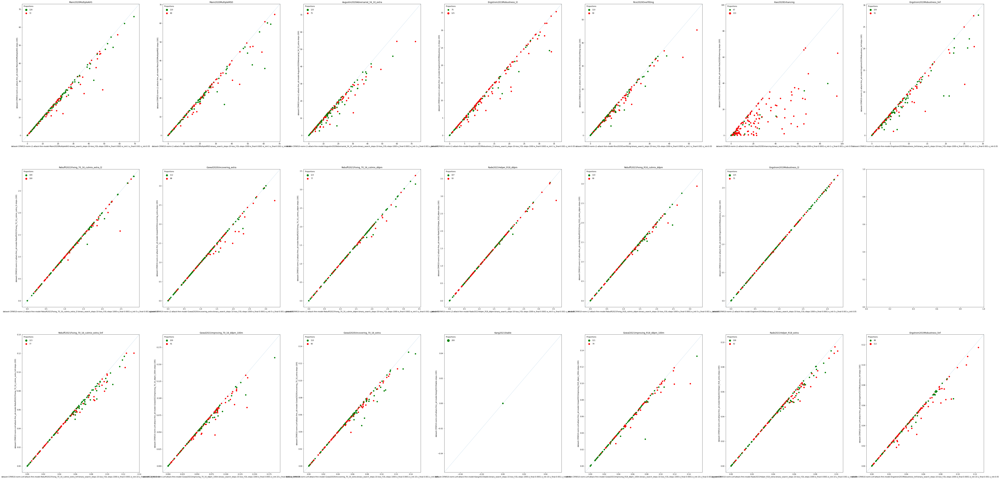

In [10]:
logger.plot_compare_grid(sumdic, a="fmn", b="fmn_all", figsize=(100,50), simple=True)
None

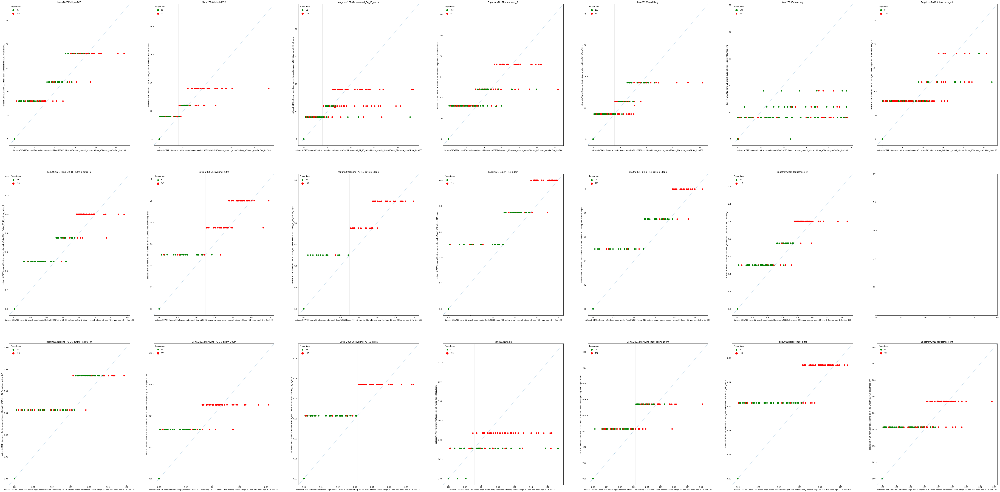

In [11]:
logger.plot_compare_grid(sumdic, a="apgd", b="auto_all", figsize=(100,50), simple=True)
None

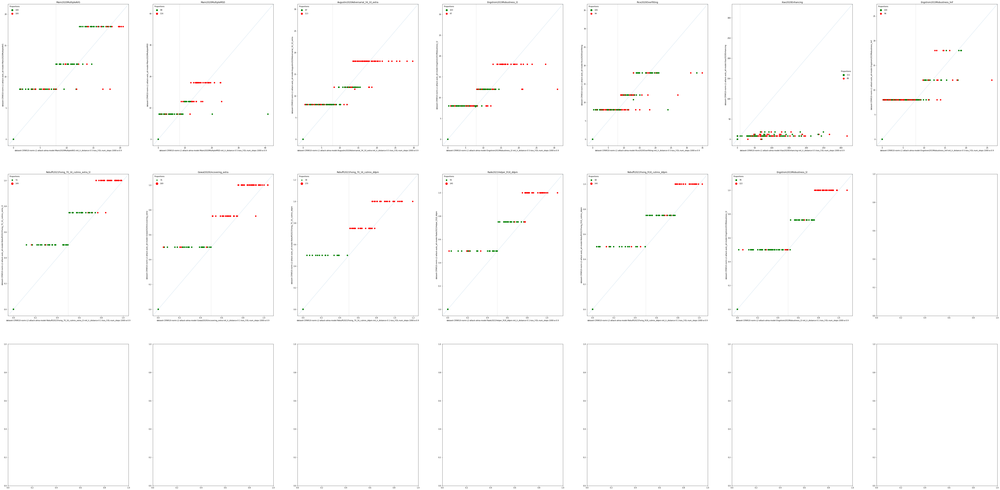

In [12]:
logger.plot_compare_grid(sumdic, a="alma", b="auto_all", figsize=(100,50), simple=True)
None

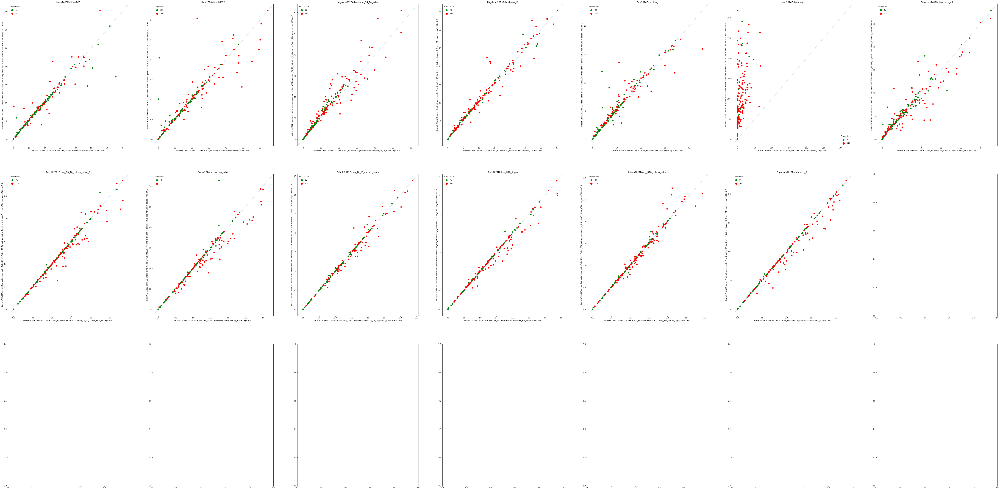

In [13]:
# size_f = lambda classes_a, classes_b: [1 if classes_a[i] != classes_b[i] else 500 for i in range(len(classes_a))]
logger.plot_compare_grid(sumdic, a="fmn_all", b="alma", figsize=(100,50), simple=True)
None

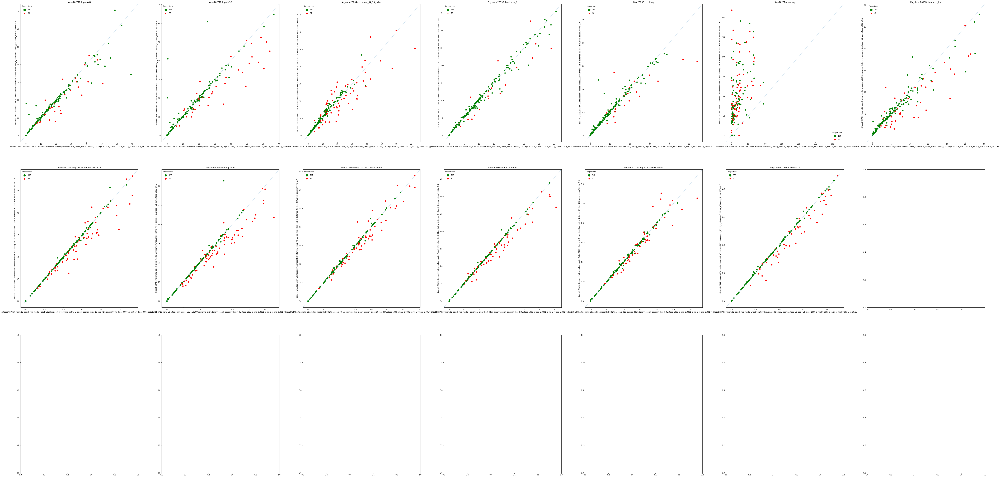

In [14]:
logger.plot_compare_grid(sumdic, a="fmn", b="alma", figsize=(100,50), simple=True)
None

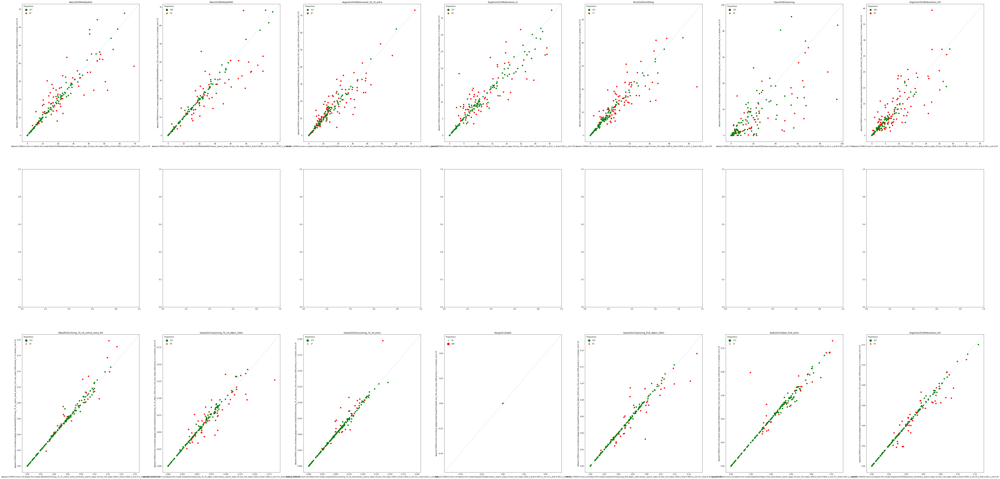

In [15]:
logger.plot_compare_grid(sumdic, a="fmn", b="pdpgd", figsize=(100,50), simple=True)
None

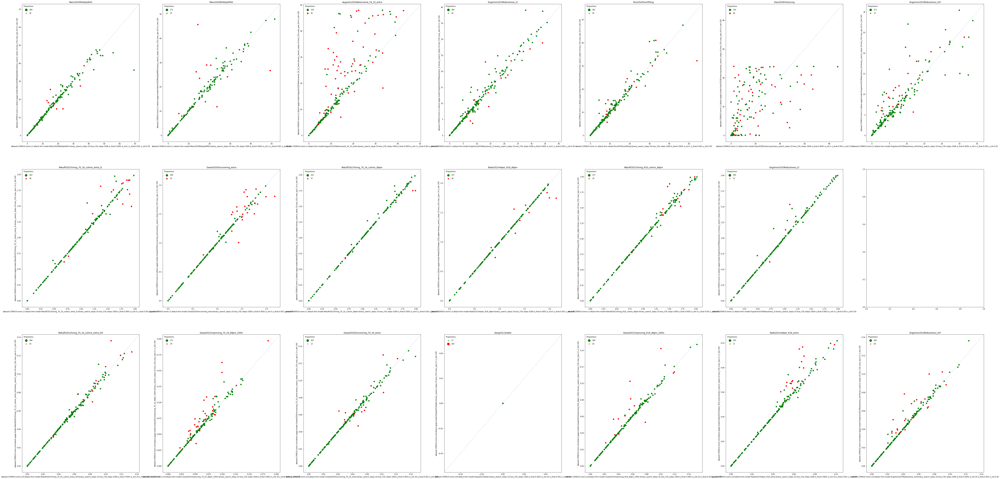

In [16]:
logger.plot_compare_grid(sumdic, a="fmn", b="apgd", figsize=(100,50), simple=True)
None

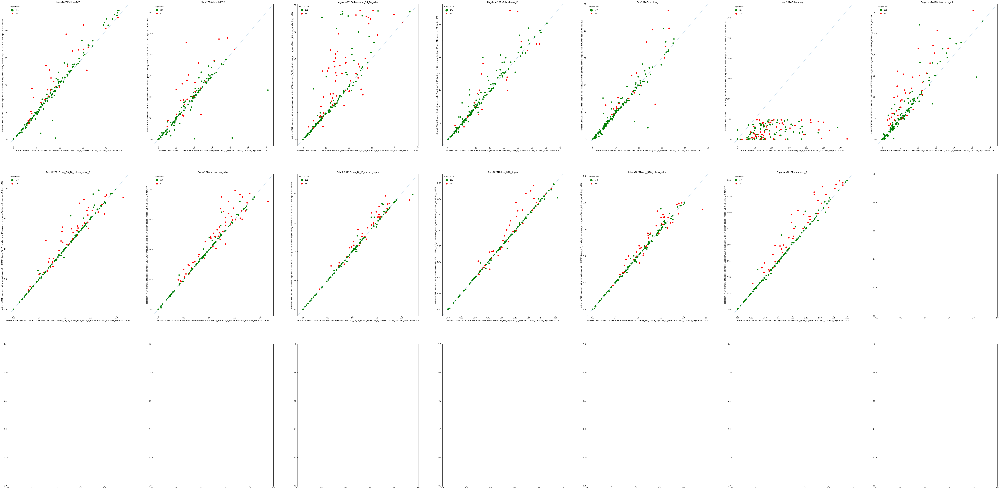

In [17]:
logger.plot_compare_grid(sumdic, a="alma", b="apgd", figsize=(100,50), simple=True)
None

In [18]:
# preventing from ensembling all wrt sample, turn on if needed 
if best_wrt_sample:
    logger = Logger(logs_dir=logger.logs_dir)
    logger.load_all()
    for norm in OPTIMAL_HYPERS:
        for model in SCORES[norm][0]:
            logger.merge(f"dataset-CIFAR10-norm-{norm}-attack-auto_all-model-{model}", [*logger.where(norm=norm, attack="aa", model=model).keys()])

    sumdic_slow, sumdic_quick = logger.extract_sumdic(OPTIMAL_HYPERS, SCORES)
    sumdic=sumdic_slow

In [19]:
logger.ensemble(OPTIMAL_HYPERS, SCORES)
sumdic, _ = logger.extract_sumdic(OPTIMAL_HYPERS, SCORES)

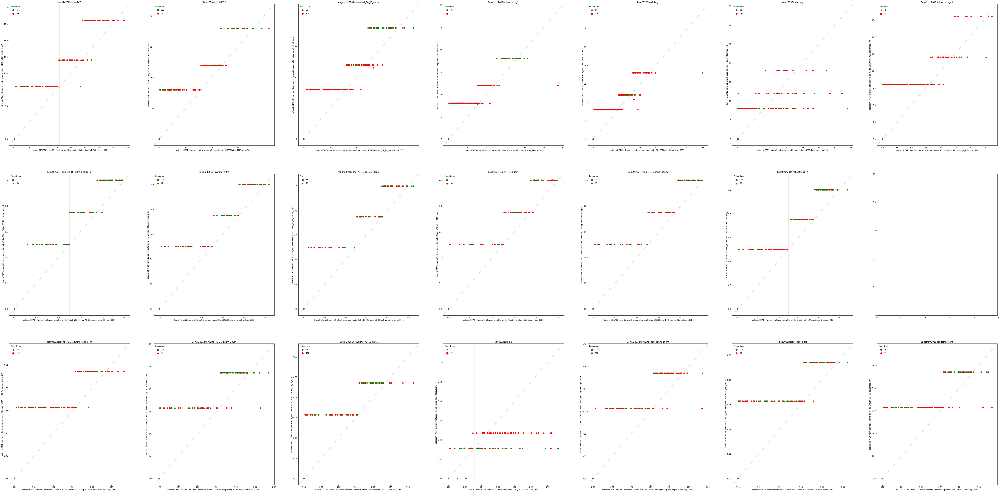

In [20]:
logger.plot_compare_grid(sumdic, a="ensemble", b="auto_all", figsize=(100,50), simple=True)
None

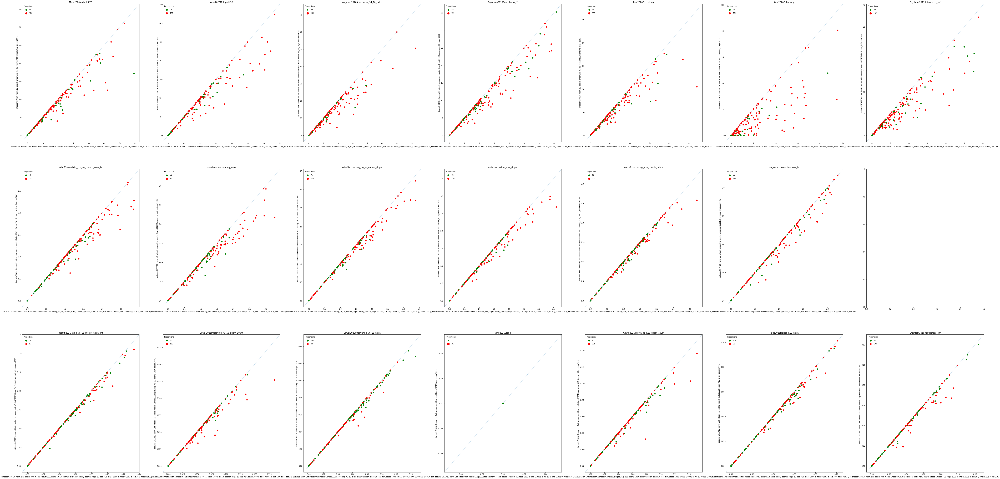

In [21]:
logger.plot_compare_grid(sumdic, a="fmn", b="ensemble", figsize=(100,50), simple=True)
None

# Detail  
- what is the "best" class for each sample, and what class was found by individual attacks?

In [22]:
logger.plot_compare_all_grid(sumdic, figsize=(200,100), initial="follow")

# Detail focus on selected samples 
detail of samples that were worse by selected attack then by AA

In [23]:
logger.plot_compare_all_grid(sumdic, figsize=(200,100), initial="follow", selected=critical)

/auto/brno6/home/xstary1/adversarial-ml-comparison/src/logging_.py:684: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if selected == "skip_same":
/auto/brno6/home/xstary1/adversarial-ml-comparison/src/logging_.py:686: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  elif selected == "only_same":


# Development of the class targeted during the untargeted attacks
TODO
--> follow up - observe the development of class targeted by the attack (FMN)

/auto/brno6/home/xstary1/adversarial-ml-comparison/src/logging_.py:424: RuntimeWarning: invalid value encountered in true_divide
  n = (min_norms/(curr["norms"].min(axis=0)))[argsorted]


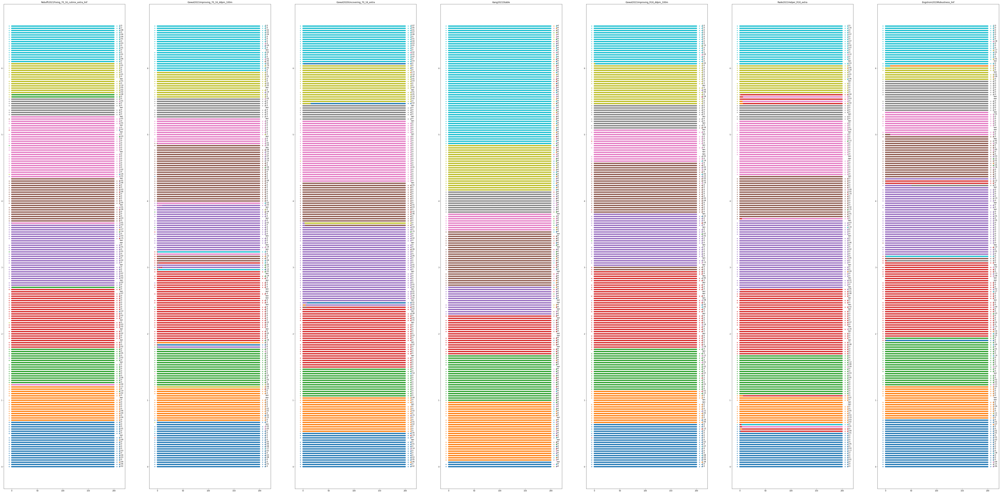

In [25]:
# from settings import OPTIMAL_HYPERS_NORM as OPTIMAL
from functools import partial 
logger.plot_grid(partial(logger.plot_targeted_class, sumdic=sumdic), figsize=(100, 50), where_settings={**OPTIMAL_HYPERS["Linf"], "attack":"fmn"})

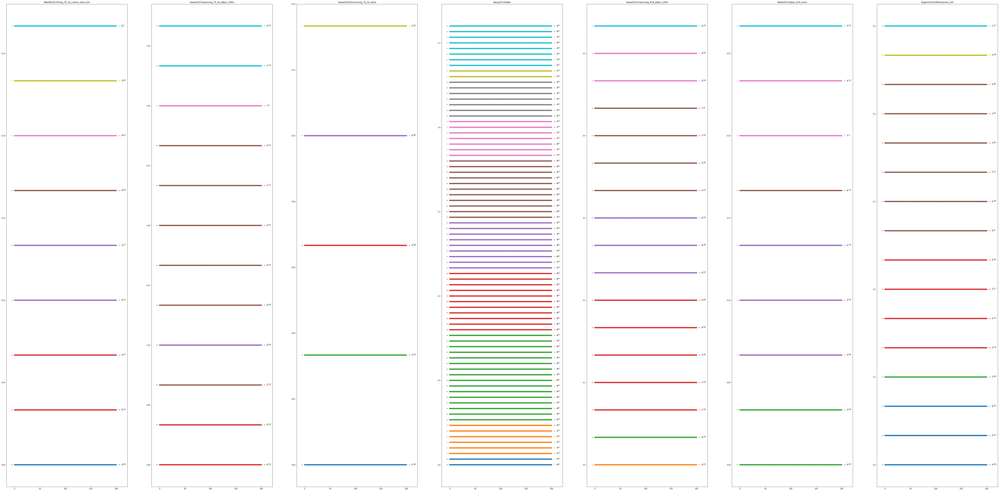

In [26]:
logger.plot_grid(partial(logger.plot_targeted_class, sumdic=sumdic, selected=critical), figsize=(100, 50), where_settings={**OPTIMAL_HYPERS["Linf"], "attack":"fmn"})

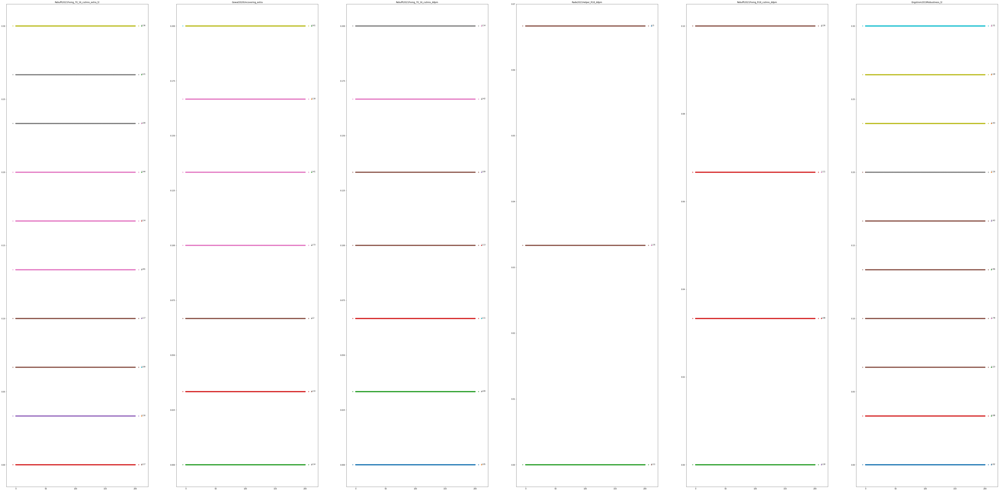

In [31]:
logger.plot_grid(partial(logger.plot_targeted_class, sumdic=sumdic, selected=critical), figsize=(100, 50), where_settings={**OPTIMAL_HYPERS["L2"], "attack":"fmn"})

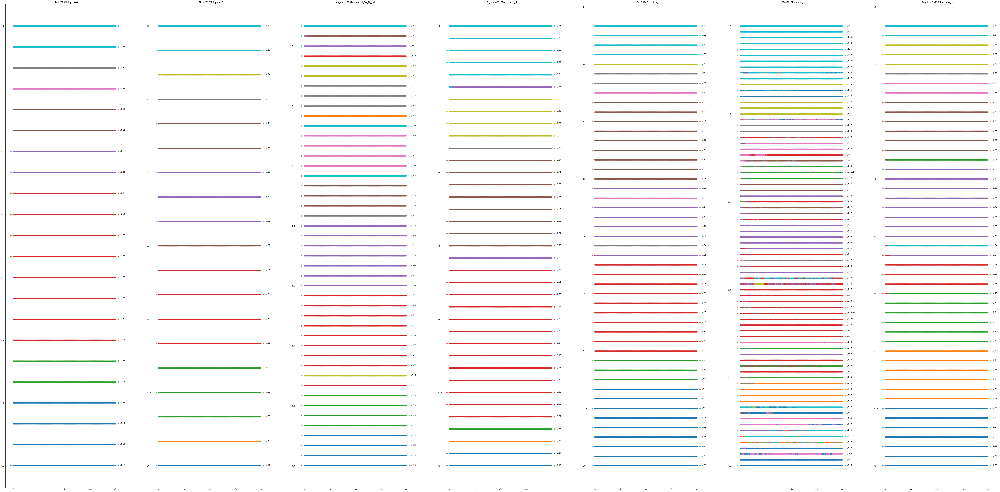

In [32]:
logger.plot_grid(partial(logger.plot_targeted_class, sumdic=sumdic, selected=critical), figsize=(100, 50), where_settings={**OPTIMAL_HYPERS["L1"], "attack":"fmn"})

/auto/brno6/home/xstary1/adversarial-ml-comparison/src/logging_.py:424: RuntimeWarning: divide by zero encountered in true_divide
  n = (min_norms/(curr["norms"].min(axis=0)))[argsorted]


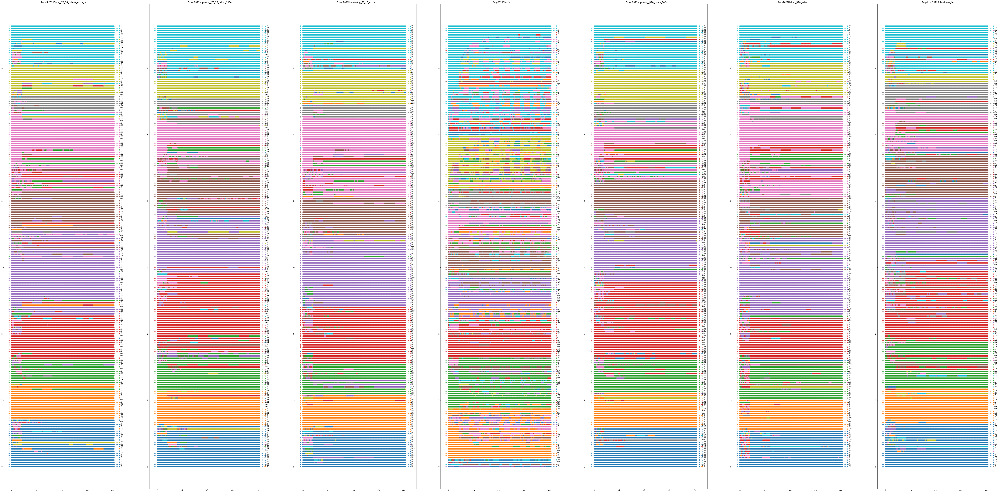

In [27]:
logger.plot_grid(partial(logger.plot_targeted_class, sumdic=sumdic), figsize=(100, 50), where_settings={**OPTIMAL_HYPERS["Linf"], "attack":"apgd"})

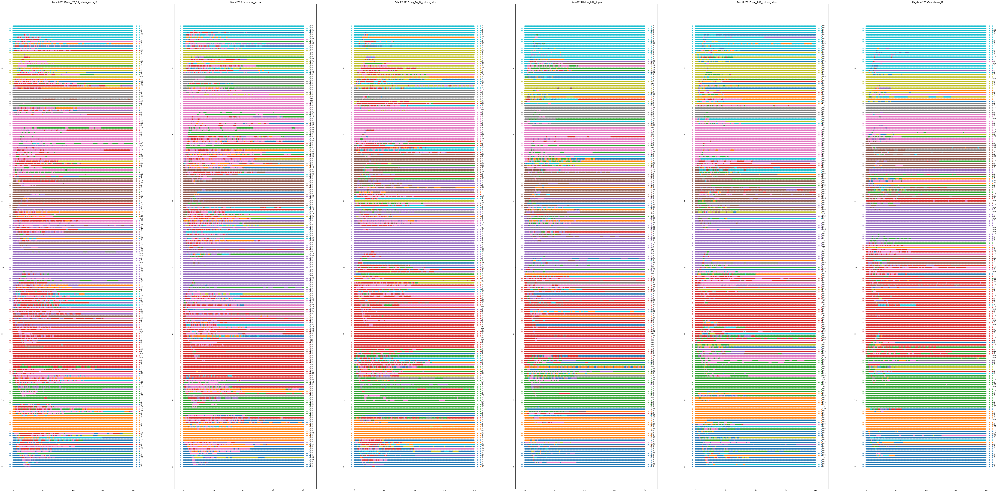

In [28]:
logger.plot_grid(partial(logger.plot_targeted_class, sumdic=sumdic), figsize=(100, 50), where_settings={**OPTIMAL_HYPERS["L2"], "attack":"alma"})

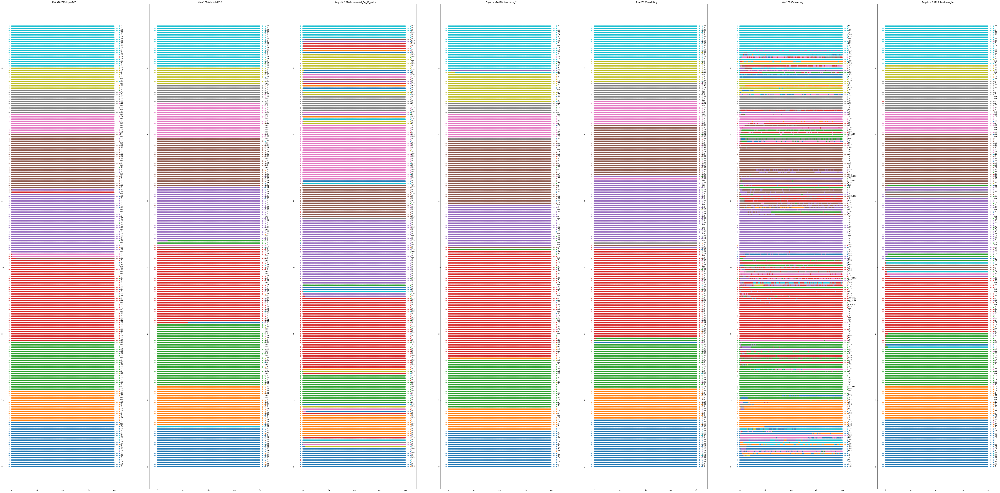

In [29]:
logger.plot_grid(partial(logger.plot_targeted_class, sumdic=sumdic), figsize=(100, 50), where_settings={**OPTIMAL_HYPERS["L1"], "attack":"fmn"})

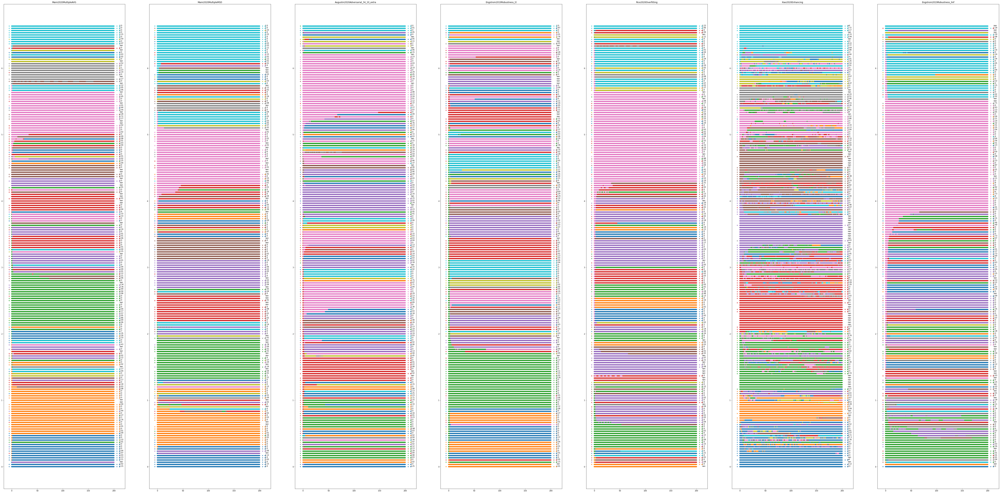

In [30]:
logger.plot_grid(partial(logger.plot_targeted_class, sumdic=sumdic), figsize=(100, 50), where_settings={**OPTIMAL_HYPERS["L1"], "attack":"pdpgd"})